Notebook for the article [Stop Loss, Trailing Stop, or Take Profit? 2 Million Backtests Shed Light](https://polakowo.medium.com/stop-loss-trailing-stop-or-take-profit-2-million-backtests-shed-light-dde23bda40be).

In [7]:
import vectorbt as vbt

import numpy as np
import pandas as pd
import itertools
from datetime import datetime, timedelta
import pytz
from numba import njit
import ipywidgets

seed = 42
symbols = [
    'BTC-USD', 'ETH-USD', 'XRP-USD', 'BCH-USD', 'LTC-USD', 
    'BNB-USD', 'EOS-USD', 'XLM-USD', 'XMR-USD', 'ADA-USD'
]
start_date = datetime(2018, 1, 1, tzinfo=pytz.utc)
end_date = datetime(2021, 1, 1, tzinfo=pytz.utc)
time_delta = end_date - start_date
window_len = timedelta(days=180)
window_count = 400
exit_types = ['SL', 'TS', 'TP', 'Random', 'Holding']
step = 0.01  # 1%
stops = np.arange(step, 1 + step, step)

# vbt.settings['plotting']['layout']['template'] = 'vbt_dark'

vbt.settings.portfolio['freq'] = '1D'
vbt.settings.portfolio['init_cash'] = 100.  # 100$
vbt.settings.portfolio['fees'] = 0.0025  # 0.25%
vbt.settings.portfolio['slippage'] = 0.0025  # 0.25%

print(pd.Series({
    'Start date': start_date,
    'End date': end_date,
    'Time period (days)': time_delta.days,
    'Assets': len(symbols),
    'Window length': window_len,
    'Windows': window_count,
    'Exit types': len(exit_types),
    'Stop values': len(stops),
    'Tests per asset': window_count * len(stops) * len(exit_types),
    'Tests per window': len(symbols) * len(stops) * len(exit_types),
    'Tests per exit type': len(symbols) * window_count * len(stops),
    'Tests per stop type and value': len(symbols) * window_count,
    'Tests total': len(symbols) * window_count * len(stops) * len(exit_types)
}))

Start date                       2018-01-01 00:00:00+00:00
End date                         2021-01-01 00:00:00+00:00
Time period (days)                                    1096
Assets                                                  10
Window length                            180 days, 0:00:00
Windows                                                400
Exit types                                               5
Stop values                                            100
Tests per asset                                     200000
Tests per window                                      5000
Tests per exit type                                 400000
Tests per stop type and value                         4000
Tests total                                        2000000
dtype: object


In [8]:
cols = ['Open', 'Low', 'High', 'Close', 'Volume']
yfdata = vbt.YFData.download(symbols, start=start_date, end=end_date)

print(yfdata.data.keys())
print(yfdata.data['BTC-USD'].shape)

dict_keys(['BTC-USD', 'ETH-USD', 'XRP-USD', 'BCH-USD', 'LTC-USD', 'BNB-USD', 'EOS-USD', 'XLM-USD', 'XMR-USD', 'ADA-USD'])
(1093, 7)


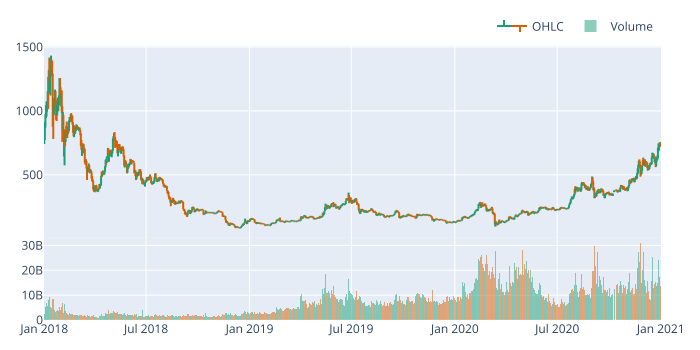

In [40]:
yfdata.data['ETH-USD'].vbt.ohlcv.plot().show_svg()

In [10]:
ohlcv = yfdata.concat()

print(ohlcv.keys())
print(ohlcv['Open'].shape)

dict_keys(['Open', 'High', 'Low', 'Close', 'Volume', 'Dividends', 'Stock Splits'])
(1093, 10)


In [11]:
split_ohlcv = {}
for k, v in ohlcv.items():
    split_df, split_indexes = v.vbt.range_split(range_len=window_len.days, n=window_count) 
    split_ohlcv[k] = split_df
ohlcv = split_ohlcv
    
print(ohlcv['Open'].shape)

(180, 4000)


In [12]:
print(ohlcv['Open'].columns)

MultiIndex([(  0, 'BTC-USD'),
            (  0, 'ETH-USD'),
            (  0, 'XRP-USD'),
            (  0, 'BCH-USD'),
            (  0, 'LTC-USD'),
            (  0, 'BNB-USD'),
            (  0, 'EOS-USD'),
            (  0, 'XLM-USD'),
            (  0, 'XMR-USD'),
            (  0, 'ADA-USD'),
            ...
            (399, 'BTC-USD'),
            (399, 'ETH-USD'),
            (399, 'XRP-USD'),
            (399, 'BCH-USD'),
            (399, 'LTC-USD'),
            (399, 'BNB-USD'),
            (399, 'EOS-USD'),
            (399, 'XLM-USD'),
            (399, 'XMR-USD'),
            (399, 'ADA-USD')],
           names=['split_idx', 'symbol'], length=4000)


In [13]:
entries = pd.DataFrame.vbt.signals.empty_like(ohlcv['Open'])
entries.iloc[0, :] = True

print(entries.shape)

(180, 4000)


In [22]:
entries

split_idx     0                                                            \
symbol    BTC-USD ETH-USD XRP-USD BCH-USD LTC-USD BNB-USD EOS-USD XLM-USD   
0            True    True    True    True    True    True    True    True   
1           False   False   False   False   False   False   False   False   
2           False   False   False   False   False   False   False   False   
3           False   False   False   False   False   False   False   False   
4           False   False   False   False   False   False   False   False   
..            ...     ...     ...     ...     ...     ...     ...     ...   
175         False   False   False   False   False   False   False   False   
176         False   False   False   False   False   False   False   False   
177         False   False   False   False   False   False   False   False   
178         False   False   False   False   False   False   False   False   
179         False   False   False   False   False   False   False   False   

split_idx                  ...     399                                  \
symbol    XMR-USD ADA-USD  ... BTC-USD ETH-USD XRP-USD BCH-USD LTC-USD   
0            True    True  ...    True    True    True    True    True   
1           False   False  ...   False   False   False   False   False   
2           False   False  ...   False   False   False   False   False   
3           False   False  ...   False   False   False   False   False   
4           False   False  ...   False   False   False   False   False   
..            ...     ...  ...     ...     ...     ...     ...     ...   
175         False   False  ...   False   False   False   False   False   
176         False   False  ...   False   False   False   False   False   
177         False   False  ...   False   False   False   False   False   
178         False   False  ...   False   False   False   False   False   
179         False   False  ...   False   False   False   False   False   

split_idx                                          
symbol    BNB-USD EOS-USD XLM-USD XMR-USD ADA-USD  
0            True    True    True    True    True  
1           False   False   False   False   False  
2           False   False   False   False   False  
3           False   False   False   False   False  
4           False   False   False   False   False  
..            ...     ...     ...     ...     ...  
175         False   False   False   False   False  
176         False   False   False   False   False  
177         False   False   False   False   False  
178         False   False   False   False   False  
179         False   False   False   False   False  

[180 rows x 4000 columns]

In [39]:
ohlcv['Close'][0]['ETH-USD'].head(50)

0      772.640991
1      884.443970
2      962.719971
3      980.921997
4      997.719971
5     1041.680054
6     1153.170044
7     1148.530029
8     1299.739990
9     1255.819946
10    1154.930054
11    1273.199951
12    1396.420044
13    1366.770020
14    1291.920044
15    1053.689941
16    1014.250000
17    1036.280029
18    1039.099976
19    1155.150024
20    1049.579956
21    1003.260010
22     986.229004
23    1058.780029
24    1056.030029
25    1055.170044
26    1107.069946
27    1246.010010
28    1182.359985
29    1071.130005
30    1118.310059
31    1036.790039
32     915.784973
33     964.018982
34     834.682007
35     697.950989
36     793.122009
37     757.067993
38     817.807007
39     883.864990
40     860.414978
41     814.659973
42     868.706970
43     845.257996
44     923.560974
45     936.976013
46     944.210022
47     974.114990
48     923.921021
49     943.864990
Name: ETH-USD, dtype: float64

In [36]:
755.757019 - (0.01*755.757019)

748.19944881

In [38]:
sl_exits[0.01][0]['ETH-USD'].head(50)

0     False
1     False
2     False
3     False
4     False
5     False
6     False
7     False
8     False
9     False
10    False
11    False
12    False
13    False
14    False
15    False
16    False
17    False
18    False
19    False
20    False
21    False
22    False
23    False
24    False
25    False
26    False
27    False
28    False
29    False
30    False
31    False
32    False
33    False
34    False
35     True
36    False
37    False
38    False
39    False
40    False
41    False
42    False
43    False
44    False
45    False
46    False
47    False
48    False
49    False
Name: ETH-USD, dtype: bool

In [42]:
entries

split_idx     0                                                            \
symbol    BTC-USD ETH-USD XRP-USD BCH-USD LTC-USD BNB-USD EOS-USD XLM-USD   
0            True    True    True    True    True    True    True    True   
1           False   False   False   False   False   False   False   False   
2           False   False   False   False   False   False   False   False   
3           False   False   False   False   False   False   False   False   
4           False   False   False   False   False   False   False   False   
..            ...     ...     ...     ...     ...     ...     ...     ...   
175         False   False   False   False   False   False   False   False   
176         False   False   False   False   False   False   False   False   
177         False   False   False   False   False   False   False   False   
178         False   False   False   False   False   False   False   False   
179         False   False   False   False   False   False   False   False   

split_idx                  ...     399                                  \
symbol    XMR-USD ADA-USD  ... BTC-USD ETH-USD XRP-USD BCH-USD LTC-USD   
0            True    True  ...    True    True    True    True    True   
1           False   False  ...   False   False   False   False   False   
2           False   False  ...   False   False   False   False   False   
3           False   False  ...   False   False   False   False   False   
4           False   False  ...   False   False   False   False   False   
..            ...     ...  ...     ...     ...     ...     ...     ...   
175         False   False  ...   False   False   False   False   False   
176         False   False  ...   False   False   False   False   False   
177         False   False  ...   False   False   False   False   False   
178         False   False  ...   False   False   False   False   False   
179         False   False  ...   False   False   False   False   False   

split_idx                                          
symbol    BNB-USD EOS-USD XLM-USD XMR-USD ADA-USD  
0            True    True    True    True    True  
1           False   False   False   False   False  
2           False   False   False   False   False  
3           False   False   False   False   False  
4           False   False   False   False   False  
..            ...     ...     ...     ...     ...  
175         False   False   False   False   False  
176         False   False   False   False   False  
177         False   False   False   False   False  
178         False   False   False   False   False  
179         False   False   False   False   False  

[180 rows x 4000 columns]

In [43]:
ohlcv['Open']

split_idx           0                                                   \
symbol          BTC-USD     ETH-USD   XRP-USD      BCH-USD     LTC-USD   
0          14112.200195  755.757019  2.296020  2534.820068  231.666000   
1          13625.000000  772.346008  2.369480  2434.500000  228.990005   
2          14978.200195  886.000000  2.464100  2700.550049  255.695007   
3          15270.700195  961.713013  3.117340  2608.870117  245.475006   
4          15477.200195  975.750000  3.300810  2400.739990  241.033997   
..                  ...         ...       ...          ...         ...   
175         6171.970215  455.936005  0.477106   748.625000   80.366600   
176         6253.549805  460.733002  0.482381   757.250000   81.815201   
177         6084.399902  432.243988  0.455551   698.284973   76.931999   
178         6153.160156  442.290009  0.470330   714.700989   80.625702   
179         5898.129883  422.587006  0.448354   662.999023   74.808899   

split_idx                                                      ...  \
symbol      BNB-USD   EOS-USD   XLM-USD     XMR-USD   ADA-USD  ...   
0           8.62953   8.76587  0.360422  349.549011  0.718847  ...   
1           8.45770   8.91344  0.496876  359.059998  0.724676  ...   
2           8.77014   9.31501  0.562720  382.743988  0.779681  ...   
3           9.44584  10.45400  0.892399  414.410004  1.094030  ...   
4           9.14568  11.23170  0.739457  402.384003  1.171150  ...   
..              ...       ...       ...         ...       ...  ...   
175        14.45700   8.07154  0.193652  121.183998  0.132321  ...   
176        14.93290   8.26364  0.196489  126.718002  0.135623  ...   
177        14.06720   7.48349  0.184523  120.632004  0.126551  ...   
178        14.03090   8.01190  0.188750  128.848999  0.127393  ...   
179        14.17430   7.47050  0.179309  117.301003  0.119397  ...   

split_idx           399                                                \
symbol          BTC-USD     ETH-USD   XRP-USD     BCH-USD     LTC-USD   
0           9124.842773  229.318954  0.177265  222.283478   41.471855   
1           9084.233398  225.288483  0.176262  221.397781   41.173149   
2           9126.090820  228.976196  0.177914  224.645355   42.022160   
3           9072.849609  227.685013  0.177017  221.843277   41.598076   
4           9349.161133  240.972595  0.188567  240.205811   43.963493   
..                  ...         ...       ...         ...         ...   
175        26280.822266  683.205811  0.283366  338.306976  127.588303   
176        27081.810547  730.358704  0.247673  362.086700  130.033264   
177        27360.089844  731.472839  0.220902  353.110199  129.061859   
178        28841.574219  751.626648  0.211787  358.768494  129.480286   
179        28994.009766  737.708374  0.219845  342.979767  124.672768   

split_idx                                                       
symbol       BNB-USD   EOS-USD   XLM-USD     XMR-USD   ADA-USD  
0          15.534174  2.384971  0.068410   65.843529  0.094318  
1          15.287059  2.418774  0.067234   62.732716  0.096652  
2          15.552996  2.459636  0.067854   64.032333  0.099965  
3          15.480226  2.407085  0.067177   63.220116  0.098211  
4          16.275965  2.609886  0.071670   64.851631  0.104957  
..               ...       ...       ...         ...       ...  
175        33.532055  2.715593  0.145099  157.266922  0.154440  
176        35.852180  2.763818  0.144359  166.488419  0.176709  
177        38.947350  2.642033  0.138760  161.384384  0.192022  
178        38.122288  2.609967  0.131989  159.367523  0.184034  
179        37.374573  2.597494  0.128321  156.570175  0.181382  

[180 rows x 4000 columns]

In [41]:
sl_exits = vbt.OHLCSTEX.run(
    entries, 
    ohlcv['Open'], 
    ohlcv['High'], 
    ohlcv['Low'], 
    ohlcv['Close'], 
    sl_stop=list(stops),
    stop_type=None, 
    hit_price=None
).exits

TypeError: run() missing 3 required positional arguments: 'high', 'low', and 'close'

In [14]:
sl_exits = vbt.OHLCSTEX.run(
    entries, 
    ohlcv['Open'], 
    ohlcv['High'], 
    ohlcv['Low'], 
    ohlcv['Close'], 
    sl_stop=list(stops),
    stop_type=None, hit_price=None
).exits
ts_exits = vbt.OHLCSTEX.run(
    entries, 
    ohlcv['Open'], 
    ohlcv['High'], 
    ohlcv['Low'], 
    ohlcv['Close'], 
    ts_stop=list(stops),
    stop_type=None, hit_price=None
).exits
tp_exits = vbt.OHLCSTEX.run(
    entries, 
    ohlcv['Open'], 
    ohlcv['High'], 
    ohlcv['Low'], 
    ohlcv['Close'], 
    tp_stop=list(stops),
    stop_type=None, hit_price=None
).exits

print(sl_exits.shape, ts_exits.shape, tp_exits.shape)

(180, 400000) (180, 400000) (180, 400000)


In [16]:
sl_exits.columns.rename('stop_value', level='ohlcstex_sl_stop', inplace=True)
ts_exits.columns.rename('stop_value', level='ohlcstex_ts_stop', inplace=True)
tp_exits.columns.rename('stop_value', level='ohlcstex_tp_stop', inplace=True)

print(sl_exits.columns)

MultiIndex([(0.01,   0, 'BTC-USD'),
            (0.01,   0, 'ETH-USD'),
            (0.01,   0, 'XRP-USD'),
            (0.01,   0, 'BCH-USD'),
            (0.01,   0, 'LTC-USD'),
            (0.01,   0, 'BNB-USD'),
            (0.01,   0, 'EOS-USD'),
            (0.01,   0, 'XLM-USD'),
            (0.01,   0, 'XMR-USD'),
            (0.01,   0, 'ADA-USD'),
            ...
            ( 1.0, 399, 'BTC-USD'),
            ( 1.0, 399, 'ETH-USD'),
            ( 1.0, 399, 'XRP-USD'),
            ( 1.0, 399, 'BCH-USD'),
            ( 1.0, 399, 'LTC-USD'),
            ( 1.0, 399, 'BNB-USD'),
            ( 1.0, 399, 'EOS-USD'),
            ( 1.0, 399, 'XLM-USD'),
            ( 1.0, 399, 'XMR-USD'),
            ( 1.0, 399, 'ADA-USD')],
           names=['stop_value', 'split_idx', 'symbol'], length=400000)


SL    0.430507
TS    0.588858
TP    0.519162
Name: avg_num_signals, dtype: float64


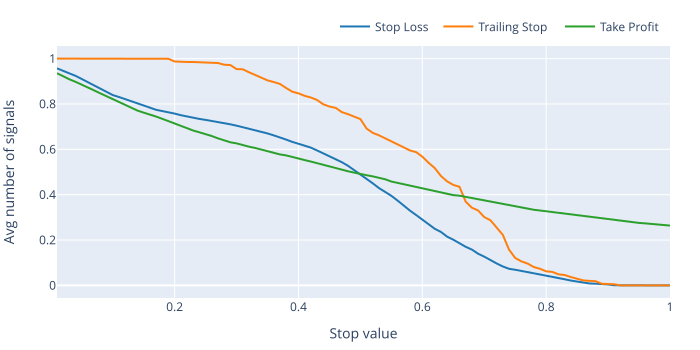

In [17]:
print(pd.Series({
    'SL': sl_exits.vbt.signals.num_signals().mean(),
    'TS': ts_exits.vbt.signals.num_signals().mean(),
    'TP': tp_exits.vbt.signals.num_signals().mean()
}, name='avg_num_signals'))

pd.DataFrame({
    'Stop Loss': sl_exits.vbt.signals.num_signals().groupby('stop_value').mean(),
    'Trailing Stop': ts_exits.vbt.signals.num_signals().groupby('stop_value').mean(),
    'Take Profit': tp_exits.vbt.signals.num_signals().groupby('stop_value').mean()
}).vbt.plot(xaxis_title='Stop value', yaxis_title='Avg number of signals').show_svg()

In [21]:
stops

array([0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 , 0.11,
       0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19, 0.2 , 0.21, 0.22,
       0.23, 0.24, 0.25, 0.26, 0.27, 0.28, 0.29, 0.3 , 0.31, 0.32, 0.33,
       0.34, 0.35, 0.36, 0.37, 0.38, 0.39, 0.4 , 0.41, 0.42, 0.43, 0.44,
       0.45, 0.46, 0.47, 0.48, 0.49, 0.5 , 0.51, 0.52, 0.53, 0.54, 0.55,
       0.56, 0.57, 0.58, 0.59, 0.6 , 0.61, 0.62, 0.63, 0.64, 0.65, 0.66,
       0.67, 0.68, 0.69, 0.7 , 0.71, 0.72, 0.73, 0.74, 0.75, 0.76, 0.77,
       0.78, 0.79, 0.8 , 0.81, 0.82, 0.83, 0.84, 0.85, 0.86, 0.87, 0.88,
       0.89, 0.9 , 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
       1.  ])

In [18]:
sl_exits.iloc[-1, :] = True
ts_exits.iloc[-1, :] = True
tp_exits.iloc[-1, :] = True

sl_exits = sl_exits.vbt.signals.first(reset_by=entries, allow_gaps=True)
ts_exits = ts_exits.vbt.signals.first(reset_by=entries, allow_gaps=True)
tp_exits = tp_exits.vbt.signals.first(reset_by=entries, allow_gaps=True)

print(pd.Series({
    'SL': sl_exits.vbt.signals.num_signals().mean(),
    'TS': ts_exits.vbt.signals.num_signals().mean(),
    'TP': tp_exits.vbt.signals.num_signals().mean()
}, name='avg_num_signals'))

SL    1.0
TS    1.0
TP    1.0
Name: avg_num_signals, dtype: float64


In [19]:
hold_exits = pd.DataFrame.vbt.signals.empty_like(sl_exits)
hold_exits.iloc[-1, :] = True

print(hold_exits.shape)

(180, 400000)


In [20]:
rand_exits = hold_exits.vbt.shuffle(seed=seed)

print(rand_exits.shape)

(180, 400000)


In [14]:
exits = pd.DataFrame.vbt.concat(
    sl_exits, 
    ts_exits, 
    tp_exits, 
    rand_exits, 
    hold_exits, 
    keys=pd.Index(exit_types, name='exit_type')
)

print(exits.shape)

(180, 2000000)


In [15]:
print(exits.columns)

MultiIndex([(     'SL', 0.01,   0, 'BTC-USD'),
            (     'SL', 0.01,   0, 'ETH-USD'),
            (     'SL', 0.01,   0, 'XRP-USD'),
            (     'SL', 0.01,   0, 'BCH-USD'),
            (     'SL', 0.01,   0, 'LTC-USD'),
            (     'SL', 0.01,   0, 'BNB-USD'),
            (     'SL', 0.01,   0, 'EOS-USD'),
            (     'SL', 0.01,   0, 'XLM-USD'),
            (     'SL', 0.01,   0, 'XMR-USD'),
            (     'SL', 0.01,   0, 'ADA-USD'),
            ...
            ('Holding',  1.0, 399, 'BTC-USD'),
            ('Holding',  1.0, 399, 'ETH-USD'),
            ('Holding',  1.0, 399, 'XRP-USD'),
            ('Holding',  1.0, 399, 'BCH-USD'),
            ('Holding',  1.0, 399, 'LTC-USD'),
            ('Holding',  1.0, 399, 'BNB-USD'),
            ('Holding',  1.0, 399, 'EOS-USD'),
            ('Holding',  1.0, 399, 'XLM-USD'),
            ('Holding',  1.0, 399, 'XMR-USD'),
            ('Holding',  1.0, 399, 'ADA-USD')],
           names=['exit_type', 'stop_value'

exit_type
Holding    179.000000
Random      89.929929
SL         124.180753
TP         113.767080
TS         103.644750
dtype: float64


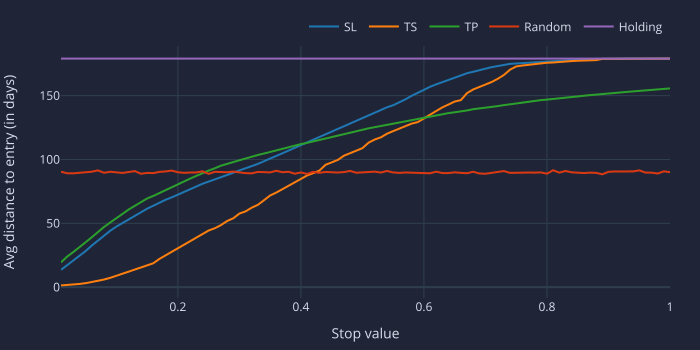

In [16]:
@njit
def distance_map_nb(entry_i, exit_i, col):
    return exit_i - entry_i

@njit
def avg_reduce_nb(col, a):
    return np.nanmean(a)

avg_distance = entries.vbt.signals.map_reduce_between(
    other=exits, 
    map_func_nb=distance_map_nb,
    reduce_func_nb=avg_reduce_nb
).groupby(['exit_type', 'stop_value']).mean().unstack(level='exit_type')

print(avg_distance.mean())

avg_distance[exit_types].vbt.plot(
    xaxis_title='Stop value', 
    yaxis_title='Avg distance to entry (in days)'
).show_svg()

In [17]:
# portfolio = vbt.Portfolio.from_signals(ohlcv['Close'], entries, exits)

# print(len(portfolio.orders()))

In [18]:
# del portfolio

from tqdm import tqdm
import gc

total_returns = []

for i in tqdm(range(len(exit_types))):
    chunk_mask = exits.columns.get_level_values('exit_type') == exit_types[i]
    chunk_exits = exits.loc[:, chunk_mask]
    chunk_portfolio = vbt.Portfolio.from_signals(ohlcv['Close'], entries, chunk_exits)
    total_returns.append(chunk_portfolio.total_return())
    
    del chunk_portfolio
    gc.collect()
    
total_return = pd.concat(total_returns)

print(total_return.shape)

100%|██████████| 5/5 [00:35<00:00,  6.53s/it]


(2000000,)


count    400000.000000
mean          0.088176
std           0.829036
min          -0.915331
50%          -0.140250
max           6.526005
Name: Holding, dtype: float64


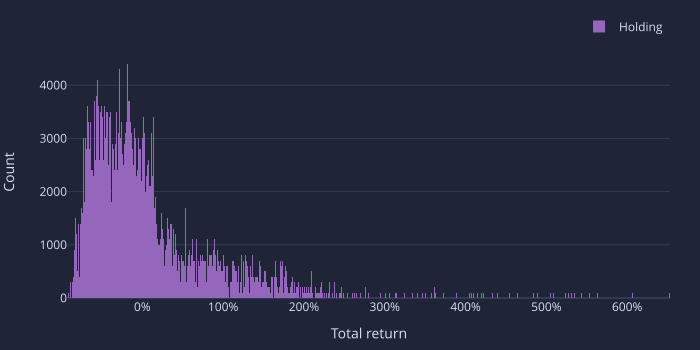

In [19]:
total_return_by_type = total_return.unstack(level='exit_type')[exit_types]

print(total_return_by_type['Holding'].describe(percentiles=[]))

total_return_by_type['Holding'].vbt.histplot(
    xaxis_title='Total return',
    xaxis_tickformat='%',
    yaxis_title='Count',
    trace_kwargs=dict(marker_color=vbt.settings['plotting']['color_schema']['purple'])
).show_svg()

In [20]:
print(pd.DataFrame({
    'Mean': total_return_by_type.mean(),
    'Median': total_return_by_type.median(),
    'Std': total_return_by_type.std(),
}))

total_return_by_type.vbt.boxplot(
    yaxis_title='Total return',
    yaxis_tickformat='%'
).show_svg()

               Mean    Median       Std
exit_type                              
SL         0.053530 -0.161138  0.764491
TS         0.052619 -0.105519  0.696602
TP         0.045477  0.078349  0.481381
Random     0.025833 -0.073704  0.574401
Holding    0.088176 -0.140250  0.829036


In [21]:
print((total_return_by_type > 0).mean().rename('win_rate'))

exit_type
SL         0.318585
TS         0.362335
TP         0.573335
Random     0.406438
Holding    0.403000
Name: win_rate, dtype: float64


exit_type
SL         5.352965
TS         5.261949
TP         4.547677
Random     2.417796
Holding    8.817578
dtype: float64


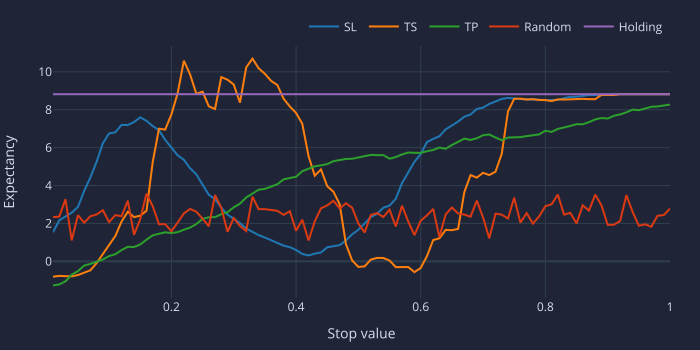

In [22]:
init_cash = vbt.settings.portfolio['init_cash']

def get_expectancy(total_return_by_type, level_name):
    grouped = total_return_by_type.groupby(level_name, axis=0)
    win_rate = grouped.apply(lambda x: (x > 0).mean())
    avg_win = grouped.apply(lambda x: init_cash * x[x > 0].mean()).fillna(0)
    avg_loss = grouped.apply(lambda x: init_cash * x[x < 0].mean()).fillna(0)
    return win_rate * avg_win - (1 - win_rate) * np.abs(avg_loss)
    
expectancy_by_stop = get_expectancy(total_return_by_type, 'stop_value')

print(expectancy_by_stop.mean())

expectancy_by_stop.vbt.plot(
    xaxis_title='Stop value', 
    yaxis_title='Expectancy'
).show_svg()

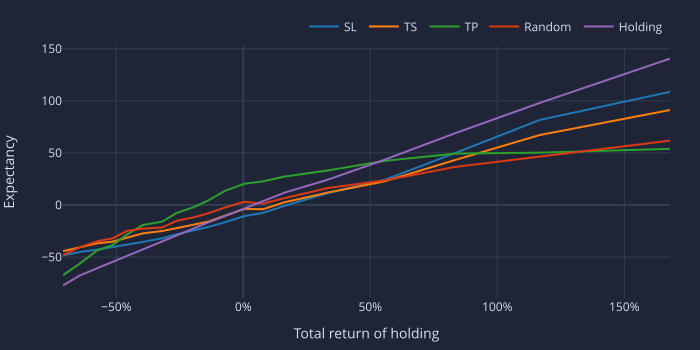

In [23]:
return_values = np.sort(total_return_by_type['Holding'].values)
idxs = np.ceil(np.linspace(0, len(return_values) - 1, 21)).astype(int)
bins = return_values[idxs][:-1]

def bin_return(total_return_by_type):
    classes = pd.cut(total_return_by_type['Holding'], bins=bins, right=True)
    new_level = pd.Index(np.array(classes.apply(lambda x: x.right)), name='bin_right')
    return total_return_by_type.vbt.stack_index(new_level, axis=0)

binned_total_return_by_type = bin_return(total_return_by_type)

expectancy_by_bin = get_expectancy(binned_total_return_by_type, 'bin_right')

expectancy_by_bin.vbt.plot(
    trace_kwargs=dict(mode='lines'),
    xaxis_title='Total return of holding',
    xaxis_tickformat='%',
    yaxis_title='Expectancy'
).show_svg()

In [24]:
range_starts = pd.DatetimeIndex(list(map(lambda x: x[0], split_indexes)))
range_ends = pd.DatetimeIndex(list(map(lambda x: x[-1], split_indexes)))

symbol_lvl = total_return_by_type.index.get_level_values('symbol')
split_idx_lvl = total_return_by_type.index.get_level_values('split_idx')
range_start_lvl = range_starts[split_idx_lvl]
range_end_lvl = range_ends[split_idx_lvl]

asset_multi_select = ipywidgets.SelectMultiple(
    options=symbols,
    value=symbols,
    rows=len(symbols),
    description='Symbols'
)
dates = np.unique(yfdata.wrapper.index)
date_range_slider = ipywidgets.SelectionRangeSlider(
    options=dates,
    index=(0, len(dates)-1),
    orientation='horizontal',
    readout=False,
    continuous_update=False
)
range_start_label = ipywidgets.Label()
range_end_label = ipywidgets.Label()
metric_dropdown = ipywidgets.Dropdown(
    options=['Mean', 'Median', 'Win Rate', 'Expectancy'],
    value='Expectancy'
)
stop_scatter = vbt.plotting.Scatter(
    trace_names=exit_types,
    x_labels=stops, 
    xaxis_title='Stop value', 
    yaxis_title='Expectancy'
)
stop_scatter_img = ipywidgets.Image(
    format='png',
    width=stop_scatter.fig.layout.width,
    height=stop_scatter.fig.layout.height
)
bin_scatter = vbt.plotting.Scatter(
    trace_names=exit_types,
    x_labels=expectancy_by_bin.index, 
    trace_kwargs=dict(mode='lines'),
    xaxis_title='Total return of holding',
    xaxis_tickformat='%',
    yaxis_title='Expectancy'
)
bin_scatter_img = ipywidgets.Image(
    format='png',
    width=bin_scatter.fig.layout.width,
    height=bin_scatter.fig.layout.height
)

In [25]:
def update_scatter(*args, **kwargs):
    _symbols = asset_multi_select.value
    _from = date_range_slider.value[0]
    _to = date_range_slider.value[1]
    _metric_name = metric_dropdown.value
    
    range_mask = (range_start_lvl >= _from) & (range_end_lvl <= _to)
    asset_mask = symbol_lvl.isin(_symbols)
    filtered = total_return_by_type[range_mask & asset_mask]
    
    filtered_binned = bin_return(filtered)
    if _metric_name == 'Mean':
        filtered_metric = filtered.groupby('stop_value').mean()
        filtered_bin_metric = filtered_binned.groupby('bin_right').mean()
    elif _metric_name == 'Median':
        filtered_metric = filtered.groupby('stop_value').median()
        filtered_bin_metric = filtered_binned.groupby('bin_right').median()
    elif _metric_name == 'Win Rate':
        filtered_metric = (filtered > 0).groupby('stop_value').mean()
        filtered_bin_metric = (filtered_binned > 0).groupby('bin_right').mean()
    elif _metric_name == 'Expectancy':
        filtered_metric = get_expectancy(filtered, 'stop_value')
        filtered_bin_metric = get_expectancy(filtered_binned, 'bin_right')
        
    stop_scatter.fig.update_layout(yaxis_title=_metric_name)
    stop_scatter.update(filtered_metric)
    stop_scatter_img.value = stop_scatter.fig.to_image(format="png")
    
    bin_scatter.fig.update_layout(yaxis_title=_metric_name)
    bin_scatter.update(filtered_bin_metric)
    bin_scatter_img.value = bin_scatter.fig.to_image(format="png")
    
    range_start_label.value = np.datetime_as_string(_from.to_datetime64(), unit='D')
    range_end_label.value = np.datetime_as_string(_to.to_datetime64(), unit='D')
    
asset_multi_select.observe(update_scatter, names='value')
date_range_slider.observe(update_scatter, names='value')
metric_dropdown.observe(update_scatter, names='value')
update_scatter()

In [26]:
dashboard = ipywidgets.VBox([
    asset_multi_select,
    ipywidgets.HBox([
        range_start_label,
        date_range_slider,
        range_end_label
    ]),
    metric_dropdown,
    stop_scatter_img,
    bin_scatter_img
])
dashboard

In [27]:
dashboard.close()